In [39]:
import os
os.environ['KMP_DUPLICATE_LIB_OK'] = 'TRUE'
import sys
import torch as t
from torch import nn, Tensor
from torch.distributions.categorical import Categorical
from torch.nn import functional as F
from dataclasses import dataclass
import numpy as np
import einops
from jaxtyping import Float, Int
from typing import Optional, Callable, Union, List, Tuple, Dict
from functools import partial
from tqdm.notebook import tqdm
from dataclasses import dataclass
from rich import print as rprint
from rich.table import Table
from IPython.display import display, HTML
from pathlib import Path
from scipy.optimize import fsolve
import matplotlib.pyplot as plt

# Make sure exercises are in the path
sys.path.append(str(Path.cwd().parent))
from plotly_utils import imshow, line, hist
from utils import (
    plot_features_in_2d,
    plot_features_in_Nd,
    plot_features_in_Nd_discrete,
    plot_correlated_features,
    plot_feature_geometry,
    frac_active_line_plot,
)


device = t.device("cuda" if t.cuda.is_available() else "cpu")

## Experiment 1: effects of sparsity on clustering


In [40]:
weights=  t.load("data/experiment_1/model.pth")["W"]

def WtW(weights: t.Tensor) -> t.Tensor:
    return einops.einsum(
        weights,
        weights,
        "instances hidden feats_i, instances hidden feats_j -> instances feats_i feats_j",)
wtw = WtW(weights)


In [42]:
feature_probability = t.load("data/experiment_1/feature_probability.pth").reshape(-1)


In [43]:
group_size = 5
diagonal_mask = t.eye(wtw.shape[1], dtype=t.bool)
group_mask = t.zeros_like(diagonal_mask, dtype=t.bool)
for group_number in range(0, wtw.shape[1], group_size):
    for i in range(group_size):
        for j in range(group_size):
            group_mask[group_number + i, group_number + j] = True
group_mask = group_mask & ~diagonal_mask

others_mask = ~group_mask & ~diagonal_mask

In [44]:
weights_diagonal =t.stack([matrix[diagonal_mask] for matrix in wtw])
weights_group = t.stack([matrix[group_mask] for matrix in wtw])
weights_others = t.stack([matrix[others_mask] for matrix in wtw])

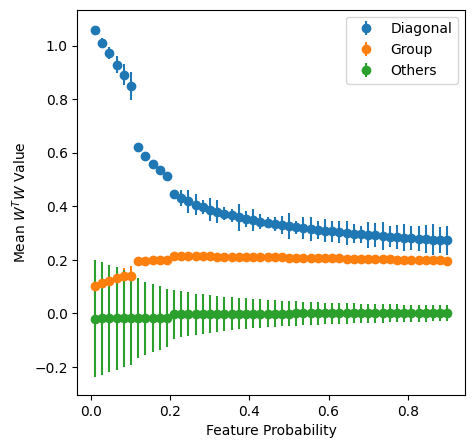

In [45]:
plt.figure(figsize=(5,5))
plt.errorbar(feature_probability, weights_diagonal.mean(dim=1), yerr=weights_diagonal.std(dim=1), fmt='o', label="Diagonal")
plt.errorbar(feature_probability, weights_group.mean(dim=1), yerr=weights_group.std(dim=1), fmt='o', label="Group")
plt.errorbar(feature_probability, weights_others.mean(dim=1), yerr=weights_others.std(dim=1), fmt='o', label="Others")
plt.legend()
plt.xlabel("Feature Probability")
plt.ylabel("Mean $W^TW$ Value")
plt.show()


### Experiment 2: effect of in-group correlation on clustering

In [47]:
weights=  t.load("data/experiment_2/model.pth")["W"]

def WtW(weights: t.Tensor) -> t.Tensor:
    return einops.einsum(
        weights,
        weights,
        "instances hidden feats_i, instances hidden feats_j -> instances feats_i feats_j",)
wtw = WtW(weights)

p_transfer = t.load("data/experiment_2/p_transfer.pth").reshape(-1)

In [49]:
weights_diagonal =t.stack([matrix[diagonal_mask] for matrix in wtw])
weights_group = t.stack([matrix[group_mask] for matrix in wtw])
weights_others = t.stack([matrix[others_mask] for matrix in wtw])

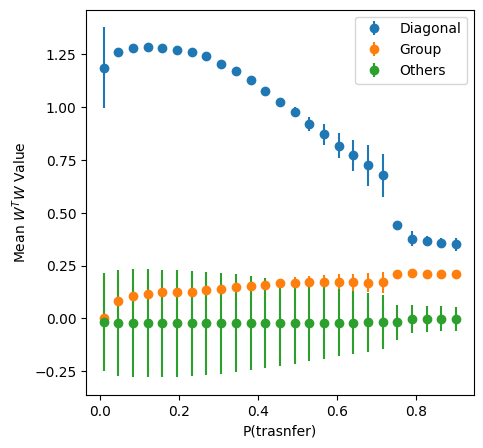

In [52]:
plt.figure(figsize=(5,5))
plt.errorbar(p_transfer, weights_diagonal.mean(dim=1), yerr=weights_diagonal.std(dim=1), fmt='o', label="Diagonal")
plt.errorbar(p_transfer, weights_group.mean(dim=1), yerr=weights_group.std(dim=1), fmt='o', label="Group")
plt.errorbar(p_transfer, weights_others.mean(dim=1), yerr=weights_others.std(dim=1), fmt='o', label="Others")
plt.legend()
plt.xlabel("P(trasnfer)")
plt.ylabel("Mean $W^TW$ Value")
plt.show()


 ### Experiment 3: effect of semantic distance within groups on clustering
 

In [64]:
weights=  t.load("data/experiment_3/model.pth")["W"]

def WtW(weights: t.Tensor) -> t.Tensor:
    return einops.einsum(
        weights,
        weights,
        "instances hidden feats_i, instances hidden feats_j -> instances feats_i feats_j",)
wtw = WtW(weights)

d_semantic = t.load("data/experiment_3/inner_goup_distance.pth").reshape(-1)

In [65]:
weights_diagonal =t.stack([matrix[diagonal_mask] for matrix in wtw])
weights_group = t.stack([matrix[group_mask] for matrix in wtw])
weights_others = t.stack([matrix[others_mask] for matrix in wtw])

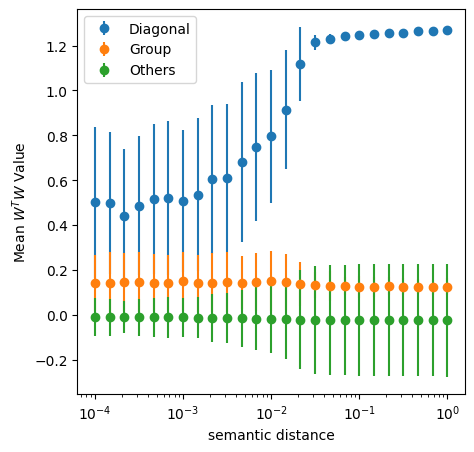

In [67]:
plt.figure(figsize=(5,5))
plt.errorbar(d_semantic, weights_diagonal.mean(dim=1), yerr=weights_diagonal.std(dim=1), fmt='o', label="Diagonal")
plt.errorbar(d_semantic, weights_group.mean(dim=1), yerr=weights_group.std(dim=1), fmt='o', label="Group")
plt.errorbar(d_semantic, weights_others.mean(dim=1), yerr=weights_others.std(dim=1), fmt='o', label="Others")
plt.legend()
plt.xscale("log")
plt.xlabel("semantic distance")
plt.ylabel("Mean $W^TW$ Value")
plt.show()


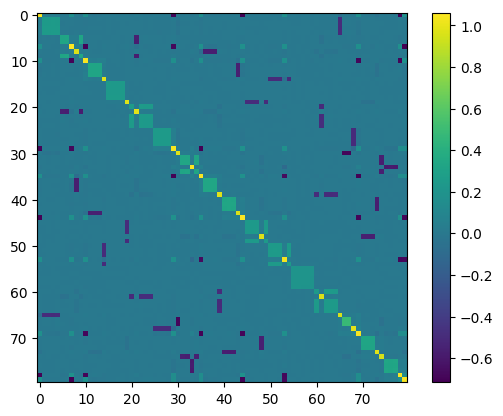

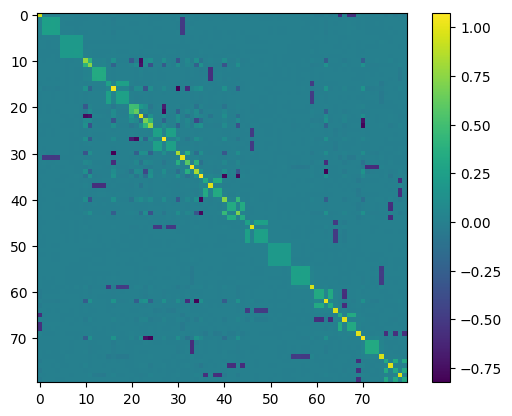

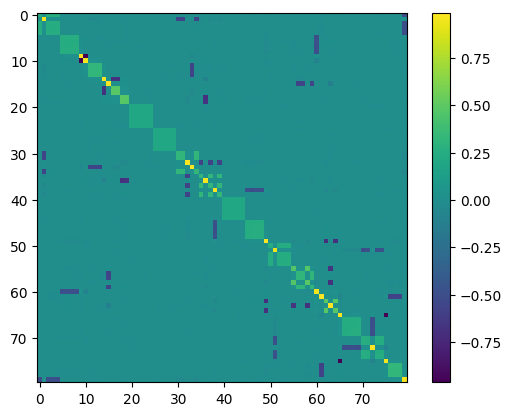

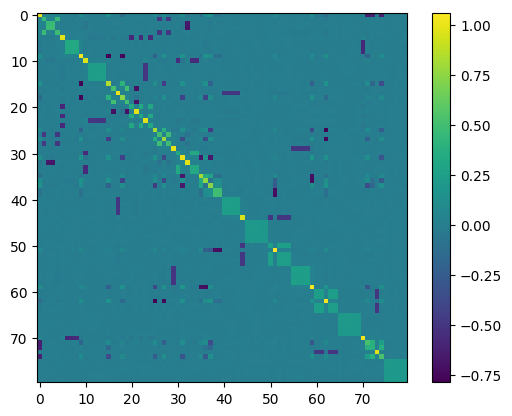

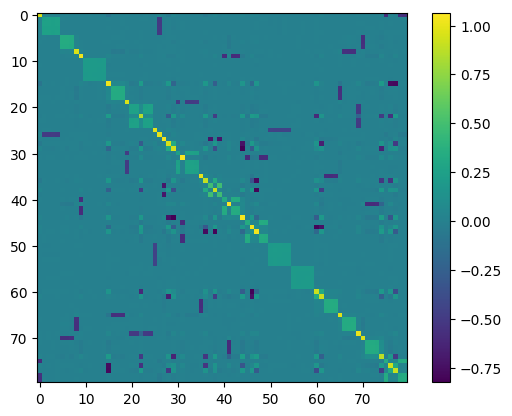

...

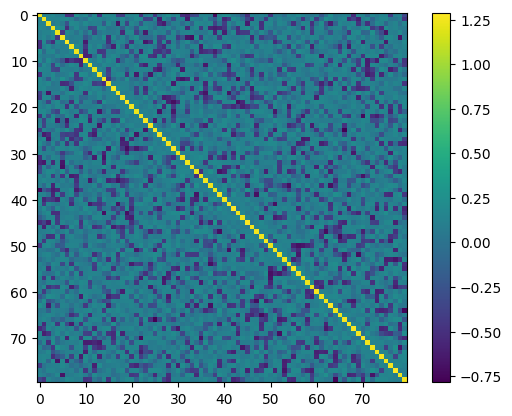

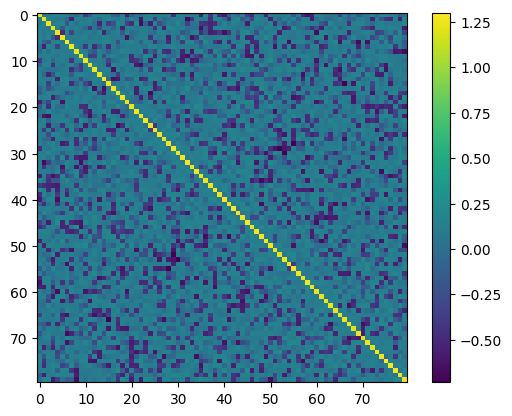

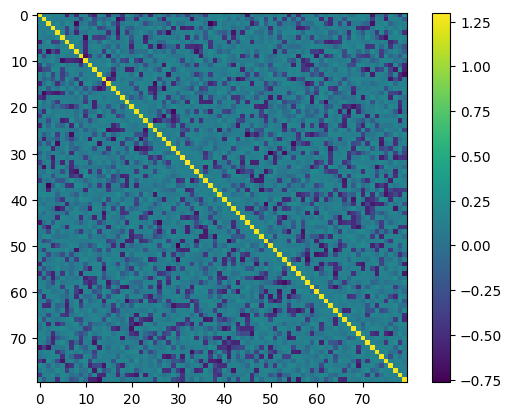

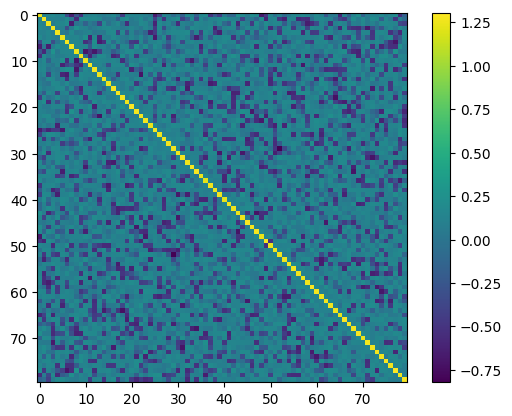

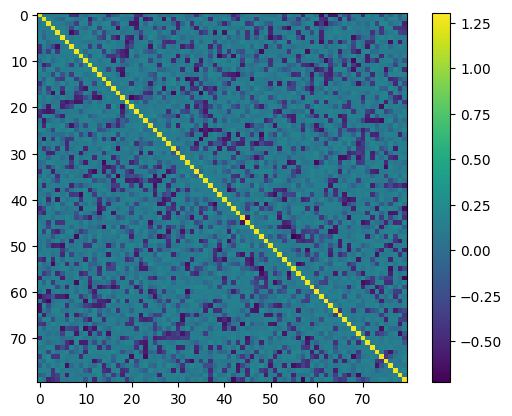

In [68]:
for matrix in wtw:
    plt.imshow(matrix)
    plt.colorbar()
    plt.show()

In [62]:
plot_features_in_Nd(
    model["W"],
    height = 600,
    width = 1400,
    title = "ReLU output model: n_features = 80, d_hidden = 20, I<sub>i</sub> = 0.9<sup>i</sup>",
    subplot_titles = [f"semantic d = {d}" for d in d_semantic],
)